In [2]:
from scipy.stats import norm
from scipy.stats import lognorm
import numpy as np

import requests
import pandas as pd

import pathlib
# explicitly require this experimental feature
from sklearn.experimental import enable_iterative_imputer  # noqa
# now you can import normally from sklearn.impute
from sklearn.impute import IterativeImputer
from sklearn.linear_model import BayesianRidge

from shapely.geometry import Point

import geopandas as gpd
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt

import rioxarray
import xarray
from geocube.api.core import make_geocube

In [7]:
xlfile = r"G:\Shared drives\UGS_Groundwater\Projects\Pahvant_Valley\TransducerData\Kanosh-Hatton area Transducers.xlsx"
df = pd.read_excel(xlfile,'Both Wells Aligned')

df.columns

Index(['Date and Time', 'WS 17 Pressure (PSI)', 'WS 17 Temperature (F)',
       'WS 17 Level Depth To Water (ft)', 'WS 19 Pressure (PSI)',
       'WS 19 Temperature (F)', 'WS 19 Level Depth To Water (ft)'],
      dtype='object')

In [9]:
df['Date and Time'] = pd.to_datetime(df['Date and Time'],errors='coerce')
df.set_index('Date and Time',inplace=True)

In [11]:
import plotly.graph_objects as go

# Assuming your DataFrame is named df and has a datetime index
# with columns 'Series1' and 'Series2'
fig = go.Figure()

# Adding the first time series
fig.add_trace(go.Scatter(
    x=df.index,
    y=df['WS 17 Level Depth To Water (ft)'],
    mode='lines',
    name='WS 17 Level Depth To Water (ft)'
))

# Adding the second time series
fig.add_trace(go.Scatter(
    x=df.index,
    y=df['WS 19 Level Depth To Water (ft)'],
    mode='lines',
    name='WS 19 Level Depth To Water (ft)'
))

# Update the layout to include a time slider
fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="1m", step="month", stepmode="backward"),
                dict(count=6, label="6m", step="month", stepmode="backward"),
                dict(count=1, label="YTD", step="year", stepmode="todate"),
                dict(count=1, label="1y", step="year", stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type="date"
    ),
    yaxis=dict(
        autorange="reversed"  # Flips the y-axis
    ),
    title="Time Series Plot with Time Slider",
    xaxis_title="Date",
    yaxis_title="Values"
)

# Show the plot
fig.show()


C:\Users\paulinkenbrandt\AppData\Local\Temp\1\ipykernel_19044\1901052903.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



<Axes: xlabel='Date and Time'>

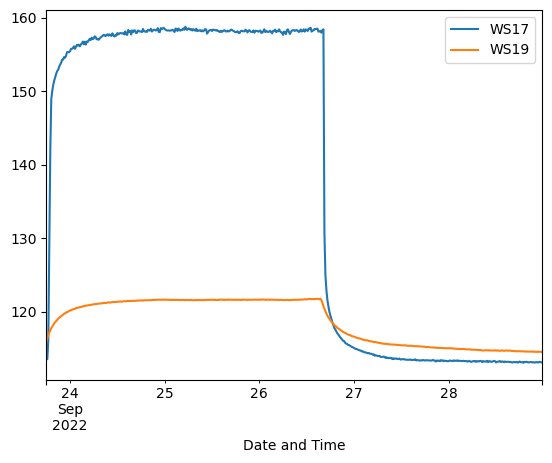

In [15]:
sept_draw = df.loc['9/23/2022 18:00':'9/28/2022']
rnm = {'WS 17 Level Depth To Water (ft)':'WS17',
       'WS 19 Level Depth To Water (ft)':'WS19'}
sept_draw.rename(rnm, axis='columns',inplace=True)
sept_draw[['WS17','WS19']].plot()


In [25]:
sept_draw = sept_draw[['WS17','WS19']]

first_index = sept_draw.first_valid_index()  # Get the first valid index
sept_draw['min'] = (sept_draw.index - first_index).total_seconds() / 60  # Calculate the difference in minutes
sept_draw['d19'] = sept_draw['WS19'] - sept_draw.loc[sept_draw.first_valid_index(),'WS19']
sept_draw['d17'] = sept_draw['WS17'] - sept_draw.loc[sept_draw.first_valid_index(),'WS17']

sept_draw[['min','d19']].round(4).to_clipboard(index=False)

In [ ]:
    yaxis=dict(
    autorange="reversed"  # Flips the y-axis
),